https://www.kaggle.com/datasets/merfarukgnaydn/counter-strike-2-body-and-head-classification

Generation of yolo models for recognition of heads in counter strike 2.

First steps in creating of machine vision aim helper)

In [1]:
import os
import cv2
import numpy as np
import zipfile
import io
import random
from matplotlib import pyplot as plt
from ultralytics import YOLO
from PIL import Image

In [6]:
REGENERATE_DATASET = True  # Convert dataset. Remove body anotations etc.
MONITOR_ORIGINAL = True  # Plot original annotations
FROM_ZIP = False  # use zip archive instead of separate files (it works faster but I can't download the full archive to the github)
TRAIN_MODEL = False  # If true - yolo model would be trained. It's prefer to run in the separate file, but I put insidy jypiter for better visual

plt.rcParams['figure.figsize'] = [15, 20]

ZIP_PATH = './dataset.zip'  # path to archive if FROM_ZIP = True

# Relative paths in the archive
TRAIN_IMG_DIR = 'train/images/'
TRAIN_LABEL_DIR = 'train/labels/'
VALIDATION_IMG_DIR = 'val/images/'
VALIDATION_LABEL_DIR = 'val/labels/'

DATASET_DIR = './datasets_original/'  # Original dataset path if FROM_ZIP = False
DATASET_GEN_DIR = './datasets/'  # destination of the generated dataset (if REGENERATE_DATASET = True)

# classes in the original dataset
ORIGINAL_CT_BODY = '1'
ORIGINAL_CT_HEAD = '2'
ORIGINAL_T_BODY = '3'
ORIGINAL_T_HEAD = '4'

ORIGINAL_CT = (int(ORIGINAL_CT_BODY), int(ORIGINAL_CT_HEAD))
ORIGINAL_T = (int(ORIGINAL_T_BODY), int(ORIGINAL_T_HEAD))

# Overrides for new classes
CT_CLS = 1
T_CLS = 1  # In the cases where teams shoudn't be separated

In [3]:
# Data set readed
class DataSet:
    class _Set:
        def __init__(self):
            self.images = []
            self.annotations = []  # only necessery classes
            
            self.originalAnnotations = []  # all classes
            
    def __init__(self):
        self._train = DataSet._Set()
        self._valid = DataSet._Set()

        self._fillData(TRAIN_IMG_DIR, TRAIN_LABEL_DIR, self._train)
        self._fillData(VALIDATION_IMG_DIR, VALIDATION_LABEL_DIR, self._valid)
        
    @property
    def train(self):
        return self._train.images, self._train.annotations
    
    @property
    def validataion(self):
        return self._valid.images, self._valid.annotations

    @property
    def original(self):
        return self._train.images, self._train.originalAnnotations
    
    def _fillData(self, imagePath, annotationPath, set_):
        for file in os.listdir(os.path.join(DATASET_DIR, imagePath)):
            self._doFill(os.path.join(DATASET_DIR, imagePath, file), imagePath, annotationPath, set_)
    
    def _convertClass(self, datasetCls, original):
        if original:
            return int(datasetCls)
        
        # I wouldn't use BODY in my model
        if datasetCls == ORIGINAL_CT_HEAD:
            return CT_CLS
        return T_CLS
    
    def _readAnnotations(self, file, original=False):
        with open(file, "r") as f:
            return self._getAnnoations(f, original)
    
    def _getAnnoations(self, file, original=False):
        lines = self._getLinesFromTxt(file)
        annotations = []
        for line in lines:
            if not line:
                continue
            
            line = line.split()
            if original or line[0] in (ORIGINAL_CT_HEAD, ORIGINAL_T_HEAD):
                annotations.append((self._convertClass(line[0], original), float(line[1]), float(line[2]), float(line[3]), float(line[4])))
        return annotations
    
    def _getLinesFromTxt(self, file):
        return file.readlines()
    
    def _doFill(self, file, imagePath, annotationPath, set_,):
        set_.images.append(self._readImage(file))
        file.replace(imagePath, annotationPath)
        txtFile = file.replace(imagePath, annotationPath).replace('.png', '.txt')
        set_.annotations.append(self._readAnnotations(txtFile))
        if MONITOR_ORIGINAL:
            set_.originalAnnotations.append(self._readAnnotations(txtFile, True))
            
    def _readImage(self, file):
        return cv2.imread(file)
    

# Reader from archive                    
class DataSetArchive(DataSet):
    def __init__(self):  
        with open(ZIP_PATH, 'rb') as f:
            raw = io.BytesIO(f.read())
            
        self._archive = zipfile.ZipFile(raw, 'r')
        
        super(DataSetArchive, self).__init__()
            
    def __del__(self):
        if self._archive is not None:
            self._archive.close()
            self._archive = None
        
    def _readImage(self, file):
        image_buffer = self._archive.open(file).read()

        # Convert the buffer as array
        pixels = np.frombuffer(image_buffer, np.uint8)

        # Load image
        img = cv2.imdecode(pixels, cv2.IMREAD_COLOR)
        return img
    
    def _fillData(self, imagePath, annotationPath, set_):
        for file in self._archive.namelist():
            if file.startswith(imagePath):
                self._doFill(file, imagePath, annotationPath, set_)
                
    def _readAnnotations(self, file, original=False):
        with self._archive.open(file) as file:
            return self._getAnnoations(file, original)
        
    def _getLinesFromTxt(self, file):
        return file.read().decode('utf-8').split('\n')


dataset = DataSetArchive() if FROM_ZIP else DataSet()

In [8]:
def regenerateDataSet(imgDir, labelDir, images, labels):
    # generates files for yolo training. IMAGES + LABELS
    
    imagesDestPath = os.path.join(DATASET_GEN_DIR, imgDir)
    if not os.path.isdir(imagesDestPath):
        os.makedirs(imagesDestPath)
        
    labelsDestPath = os.path.join(DATASET_GEN_DIR, labelDir)
    if not os.path.isdir(labelsDestPath):
        os.makedirs(labelsDestPath)
        
    i = 1
    for img, annotations in zip(images, labels):
        cv2.imwrite(os.path.join(imagesDestPath, f'img_{i}.png'), img)
        
        with open(os.path.join(labelsDestPath, f'img_{i}.txt'), 'w+') as f:
            for annotation in annotations:
                f.write(' '.join(str(el) for el in annotation) + '\n')
        
        i += 1

if REGENERATE_DATASET:
    images, annotations = dataset.train
    regenerateDataSet(TRAIN_IMG_DIR, TRAIN_LABEL_DIR, images, annotations)
    images, annotations = dataset.validataion
    regenerateDataSet(VALIDATION_IMG_DIR, VALIDATION_LABEL_DIR, images, annotations)

    # should be configured in a cases whenever both teams should be separated
    yamlStr = '''
    train: ./train
    val: ./val
    nc: 2
    names: ["none", "head"]
    '''
    with open("data.yaml", "w") as f:
        f.write(yamlStr)

In [6]:
def trainModel(yoloModel, out):
    random.seed(42)
    np.random.seed(42)

    model = YOLO(yoloModel)
    
    # Training.
    results = model.train(
        data='data.yaml', 
        imgsz=1920,
        epochs=200, 
        batch=2, 
        name=out,
        fliplr=0.5,
        shear=5.0,
        )
    
    with open(f'./runs/detect/{out}/weights/best.pt', 'rb') as fsrc:
        with open(f'./{out}.pt', 'wb') as fdst:
            fdst.write(fsrc.read())
        
if TRAIN_MODEL:
    trainModel('yolov8n.pt', 'outputmodel')

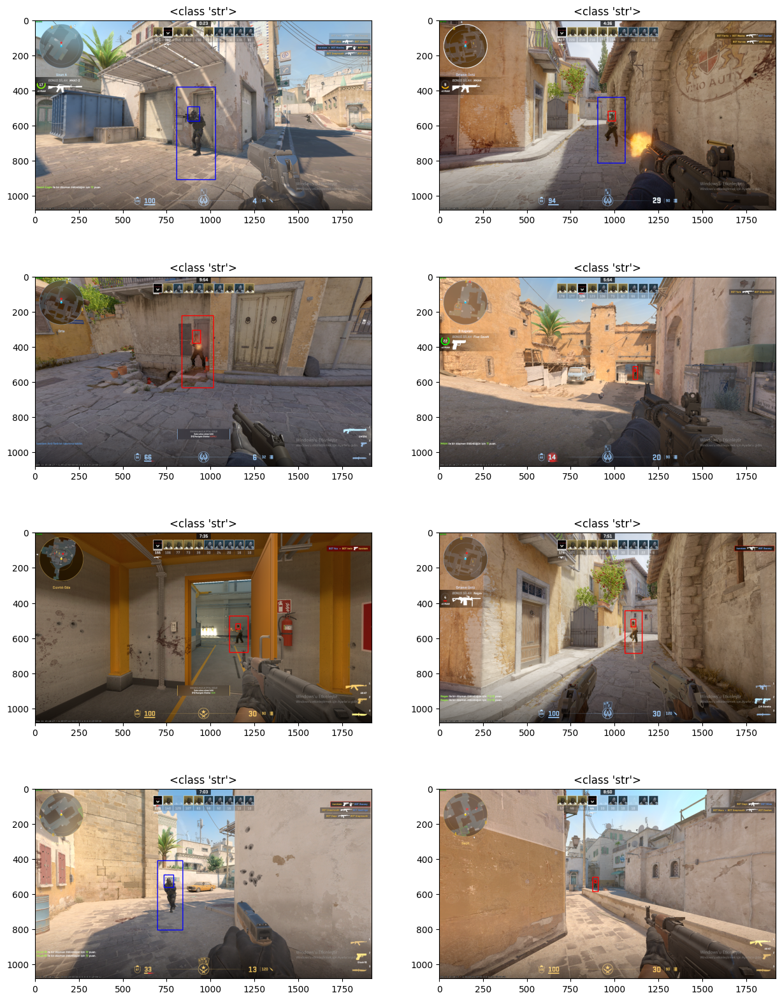

In [7]:
def convertRect(annotation, imgShape):
    imgHeight, imgWidth = imgShape
    _, x, y, w, h = annotation
    tl = (int(imgWidth * (x - w)), int(imgHeight * (y - h)))
    br = (int(imgWidth * (x + w)), int(imgHeight * (y + h)))
    return tl, br

def getColor(clsId, ctClasses):
    if clsId in ctClasses:  # CT
        return (0, 0, 255)
    else:  # T
        return (255, 0, 0)
        

def plot(data, color):
    images, annotations = data
    for i in range(1, 5):
        idx = random.randint(0, len(images) - 1)
        img = images[idx]
        
        img = np.copy(img)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        for annotation in annotations[idx]:
            tl, br = convertRect(annotation, img.shape[:2])
            cv2.rectangle(img, tl, br, getColor(annotation[0], color), 3)
                
        plt.subplot(2, 2, i), plt.imshow(img), plt.title(str)

if MONITOR_ORIGINAL:   
    plot(dataset.original, ORIGINAL_CT)
    

As we can see there are some mistakes in the original dataset

Lets check only interested annotations

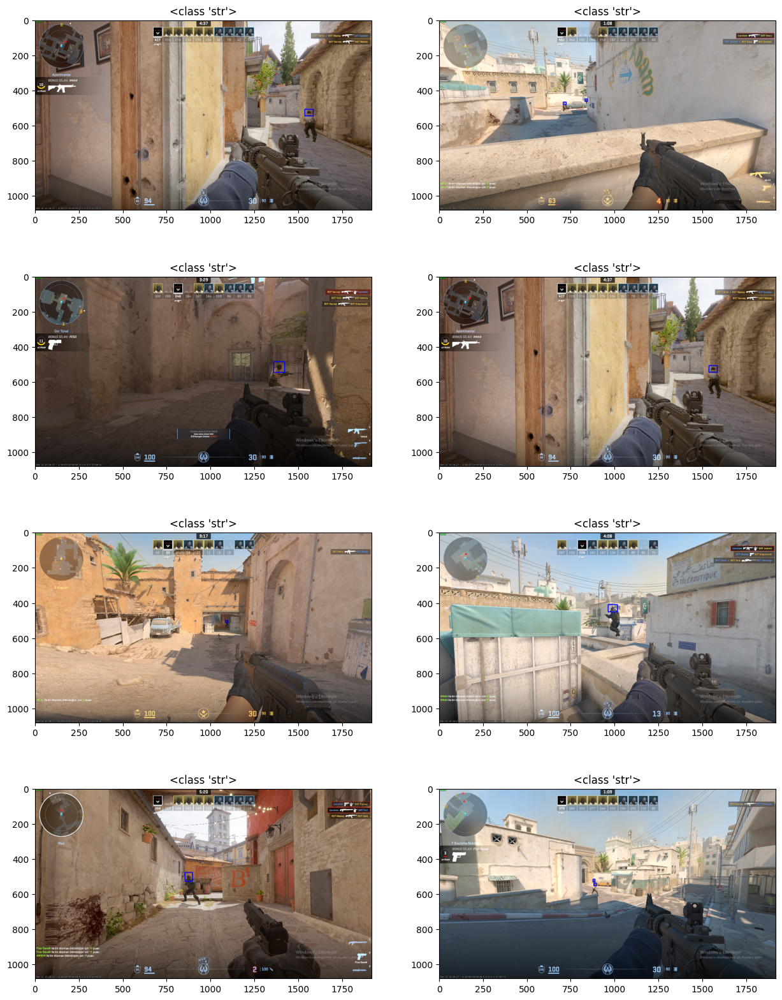

In [8]:
plot(dataset.train, (CT_CLS, ))

Ok. Models were trained.

I've prepered few models
* 1920n200single  - (yolo8n) teams are joined. 200 epoches
* S_1920_2_300.pt  - (yolo8s) separated teams. 300 epoches 
* N_1920_2_200.pt  - (yolo8n) separated teams. 200 epoches 

each model takes to the input full hd image


0: 1088x1920 1 head, 14.7ms
Speed: 6.5ms preprocess, 14.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1088, 1920)

0: 1088x1920 1 head, 14.0ms
Speed: 7.8ms preprocess, 14.0ms inference, 1.9ms postprocess per image at shape (1, 3, 1088, 1920)

0: 1088x1920 1 head, 13.3ms
Speed: 6.9ms preprocess, 13.3ms inference, 2.4ms postprocess per image at shape (1, 3, 1088, 1920)

0: 1088x1920 1 head, 13.2ms
Speed: 5.9ms preprocess, 13.2ms inference, 2.1ms postprocess per image at shape (1, 3, 1088, 1920)


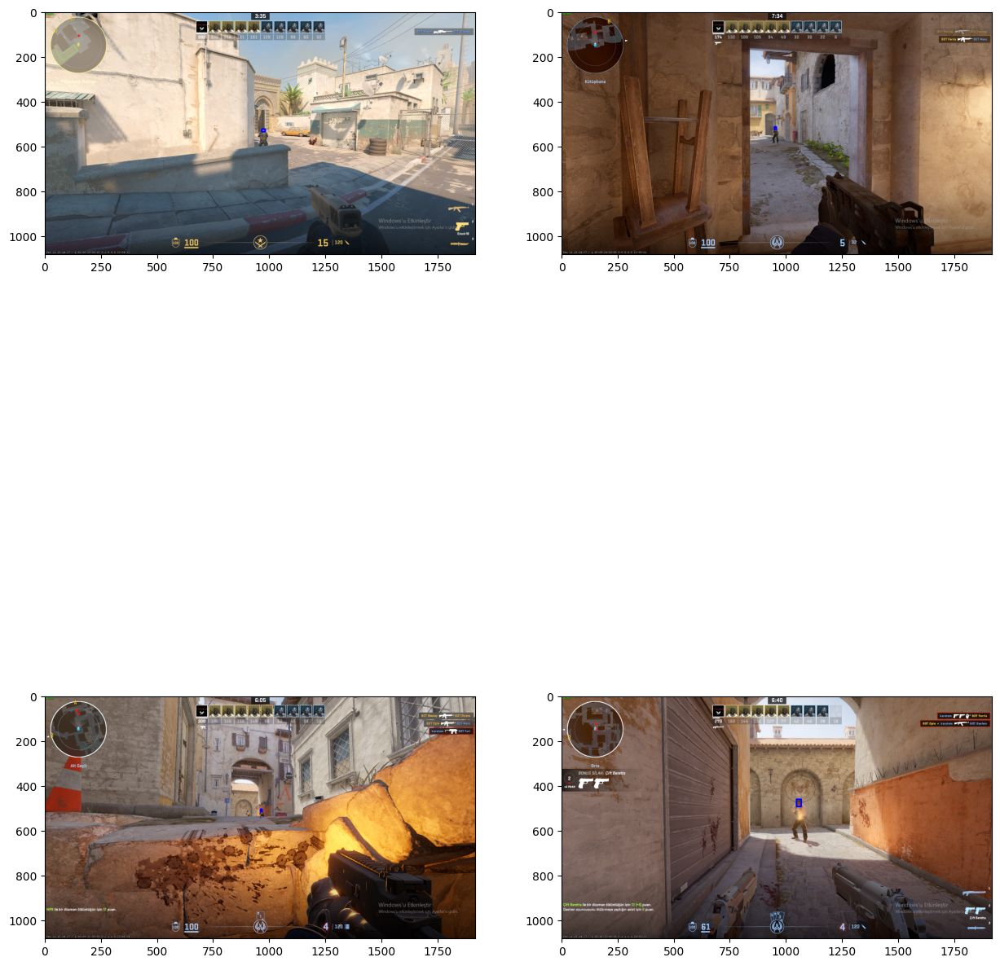

In [13]:
model = YOLO('./1920n200single.pt')

path = './datasets/val/images/'

for i in range(1, 5):
    images, _ = dataset.validataion
    image = random.choice(images)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    results = model(image)
    for result in results:
        boxes = result.boxes.cpu().numpy().xyxy.astype(np.int16)
        class_ids = result.boxes.cls.cpu().numpy().astype(int)

        for box_idx, box in enumerate(boxes):
            start, stop = box[0:2], box[2:]
            color = (0, 0, 255) if class_ids[box_idx] == CT_CLS else (255, 0, 0)
            cv2.rectangle(image, start, stop, color, thickness=5)

        plt.subplot(2,2,i), plt.imshow(image)


Lets check in numbers

In [10]:
results = model.val(data='data.yaml', conf=0.2)

Ultralytics YOLOv8.2.70 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce RTX 3060, 12287MiB)


val: Scanning /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:07<00:00,  1.23s/it]


                   all         90        110      0.971        0.9      0.944      0.677
                  head         90        110      0.971        0.9      0.944      0.677
Speed: 12.0ms preprocess, 12.5ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val


90% of accuracy. Not bad

Lets draw with alter method that used for yolo models


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_54.png: 1088x1920 1 head, 13.1ms
Speed: 4.9ms preprocess, 13.1ms inference, 1.3ms postprocess per image at shape (1, 3, 1088, 1920)


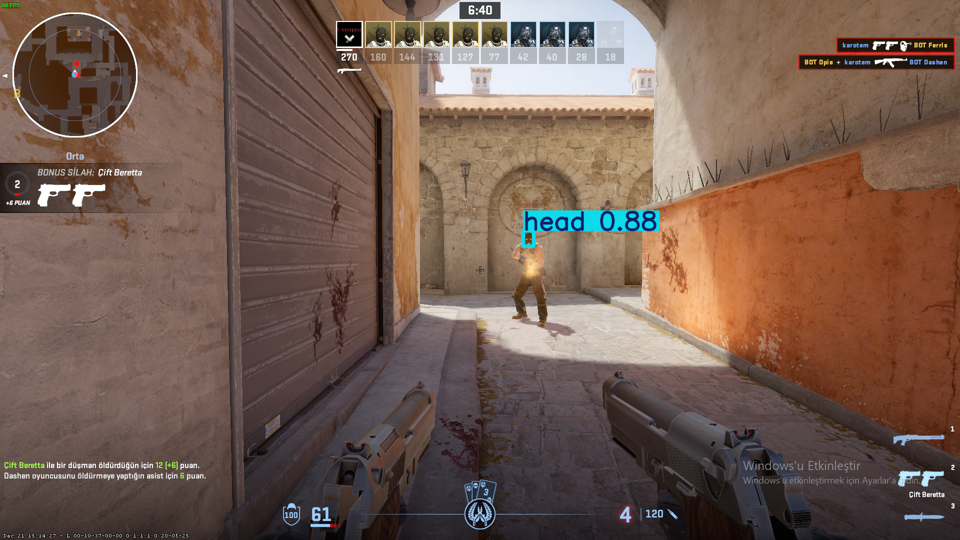


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_46.png: 1088x1920 1 head, 13.3ms
Speed: 4.9ms preprocess, 13.3ms inference, 1.4ms postprocess per image at shape (1, 3, 1088, 1920)


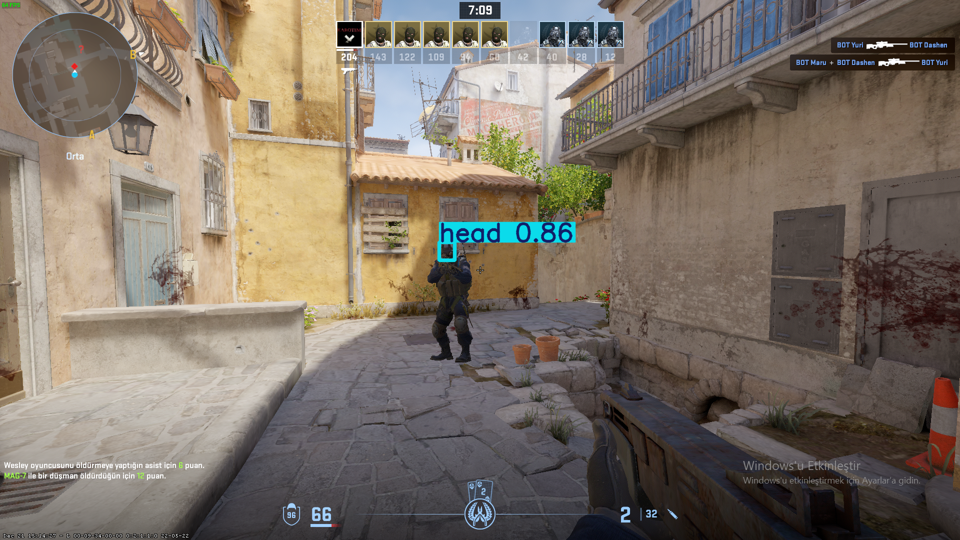


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_36.png: 1088x1920 1 head, 13.3ms
Speed: 4.6ms preprocess, 13.3ms inference, 1.4ms postprocess per image at shape (1, 3, 1088, 1920)


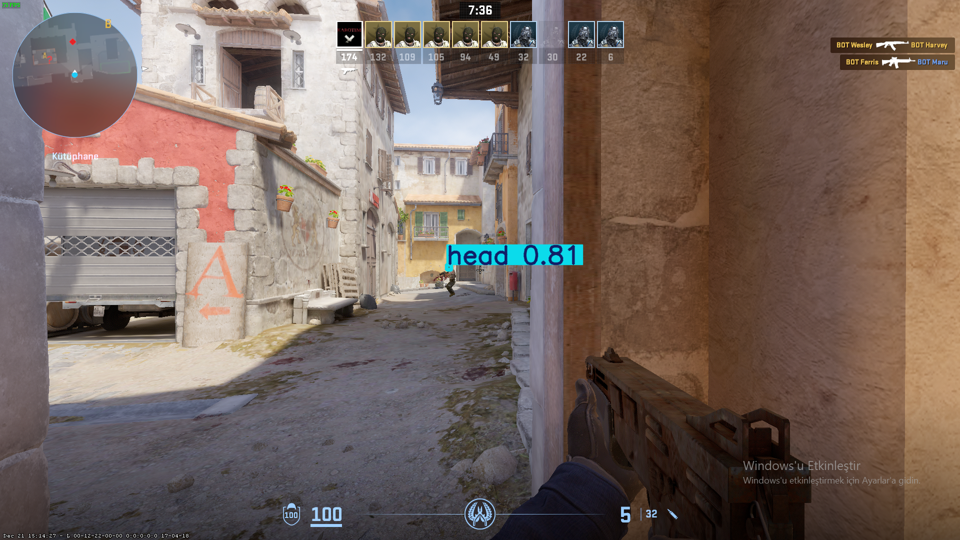


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_67.png: 1088x1920 1 head, 13.8ms
Speed: 4.6ms preprocess, 13.8ms inference, 1.4ms postprocess per image at shape (1, 3, 1088, 1920)


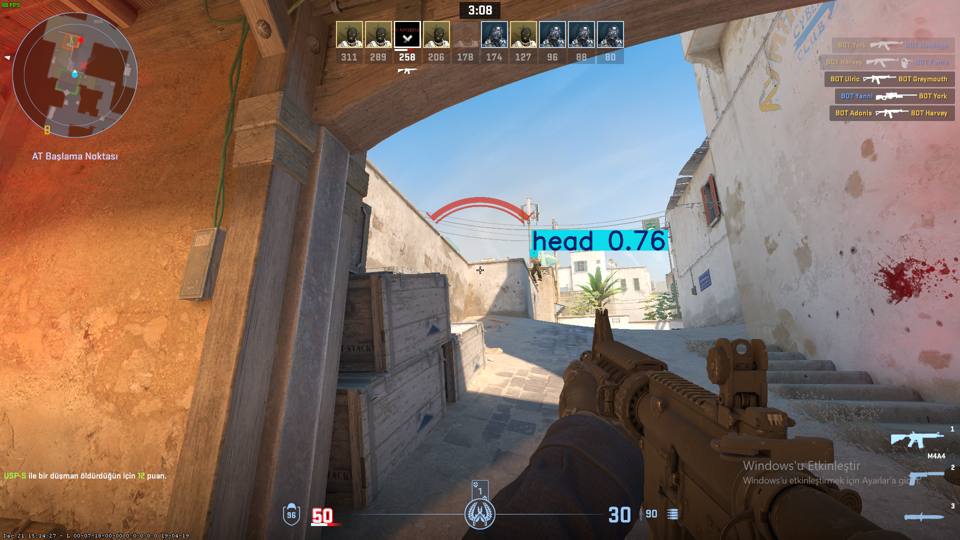


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_34.png: 1088x1920 1 head, 12.3ms
Speed: 4.8ms preprocess, 12.3ms inference, 1.3ms postprocess per image at shape (1, 3, 1088, 1920)


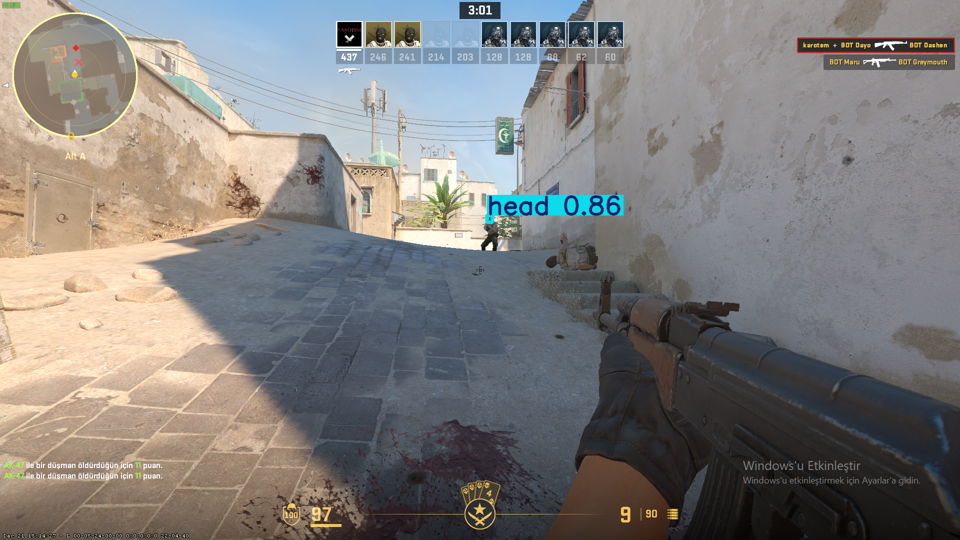


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_37.png: 1088x1920 1 head, 28.2ms
Speed: 5.8ms preprocess, 28.2ms inference, 2.2ms postprocess per image at shape (1, 3, 1088, 1920)


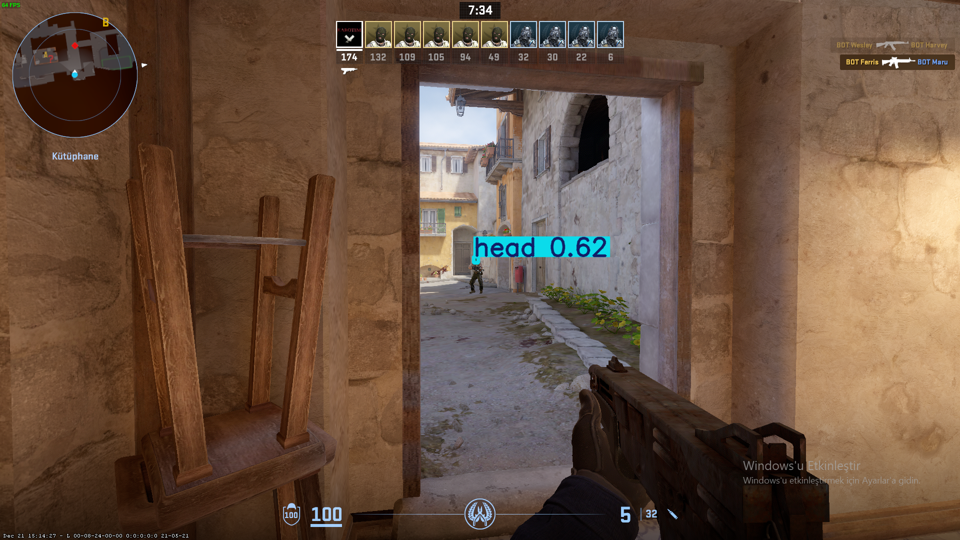

In [16]:
path = './datasets/val/images/'
validationImgCount = len(dataset.validataion[0])
    
def plotWithPIL(modelName):
    model = YOLO(modelName)

    for i in range(1, 7):
        idx = random.randint(1, validationImgCount - 1)
        file = os.path.join(path, f'img_{idx}.png')
        results = model(file) 

        # Show the results
        for r in results:
            im_array = r.plot()  
            im = Image.fromarray(im_array[..., ::-1])  
            im = im.resize((960, 540))
            im.show() 

plotWithPIL('./1920n200single.pt')

Lets check model that don't join teams


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_4.png: 1088x1920 1 ct, 16.5ms
Speed: 5.1ms preprocess, 16.5ms inference, 3.0ms postprocess per image at shape (1, 3, 1088, 1920)


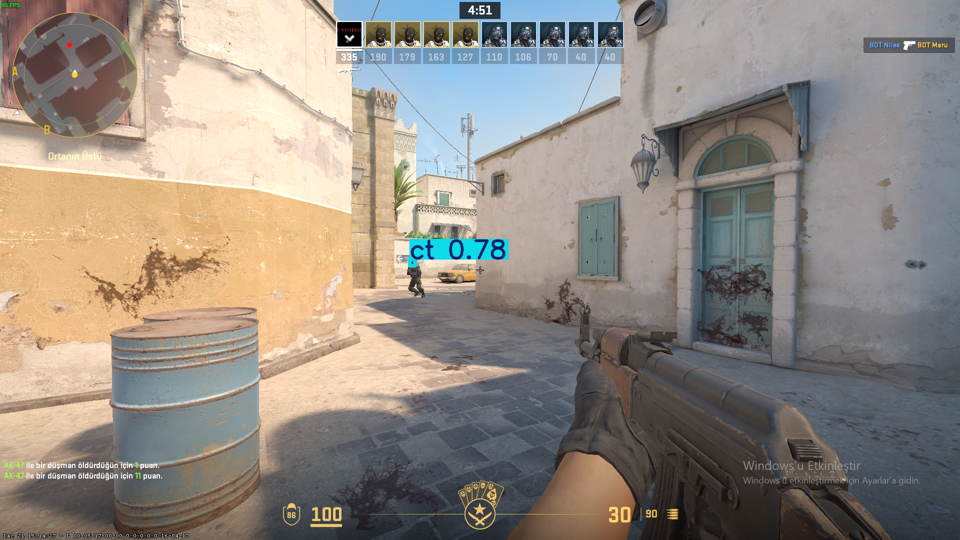


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_49.png: 1088x1920 1 ct, 1 t, 12.4ms
Speed: 5.2ms preprocess, 12.4ms inference, 1.3ms postprocess per image at shape (1, 3, 1088, 1920)


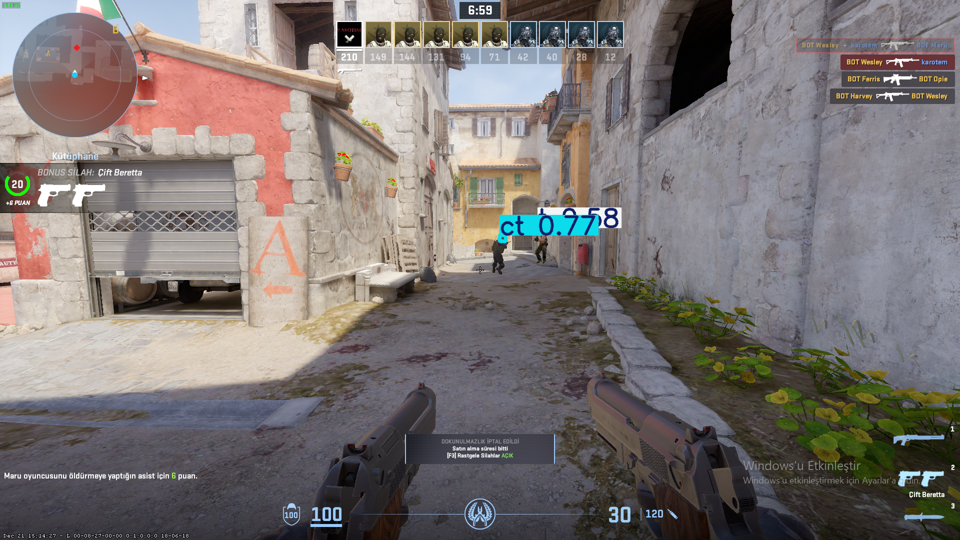


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_77.png: 1088x1920 1 t, 12.9ms
Speed: 5.3ms preprocess, 12.9ms inference, 2.1ms postprocess per image at shape (1, 3, 1088, 1920)


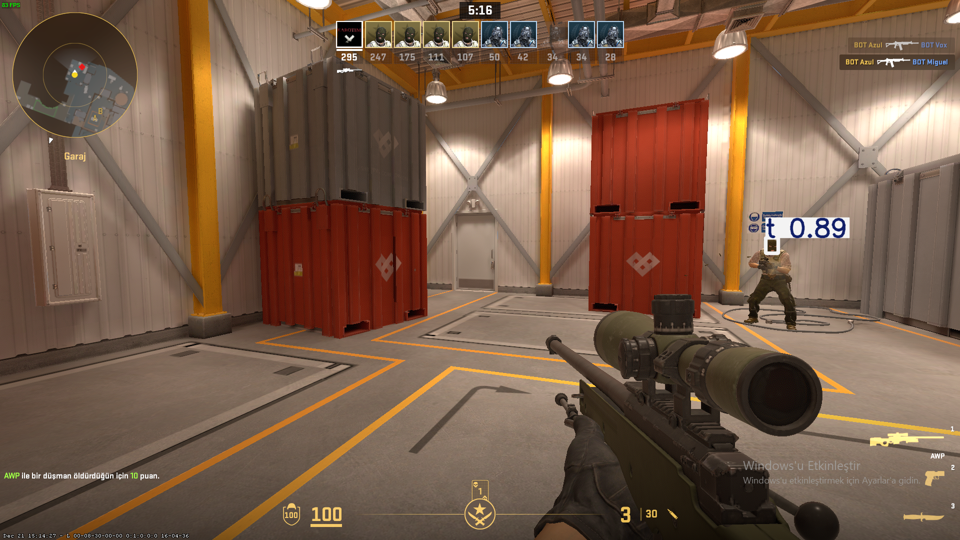


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_65.png: 1088x1920 (no detections), 13.4ms
Speed: 4.7ms preprocess, 13.4ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)


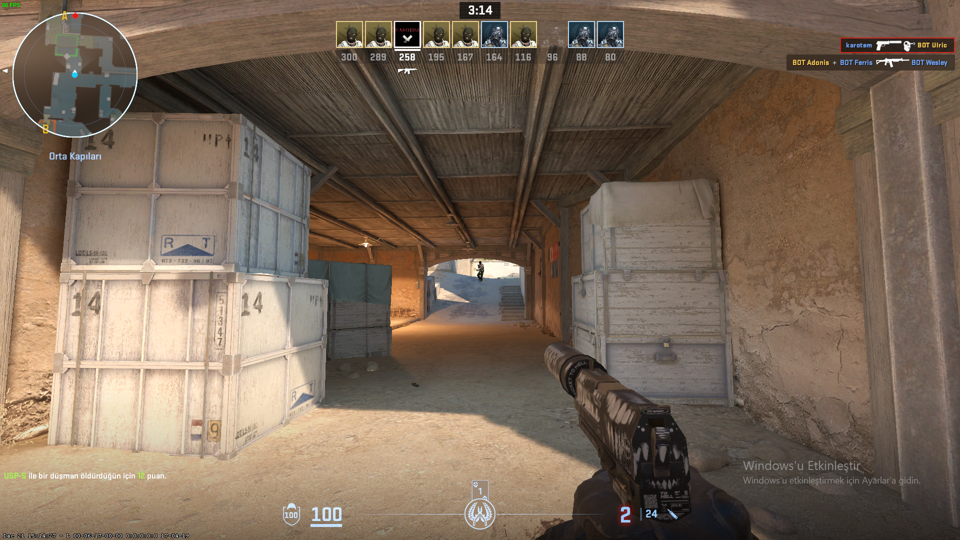


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_33.png: 1088x1920 2 ts, 12.4ms
Speed: 5.8ms preprocess, 12.4ms inference, 1.4ms postprocess per image at shape (1, 3, 1088, 1920)


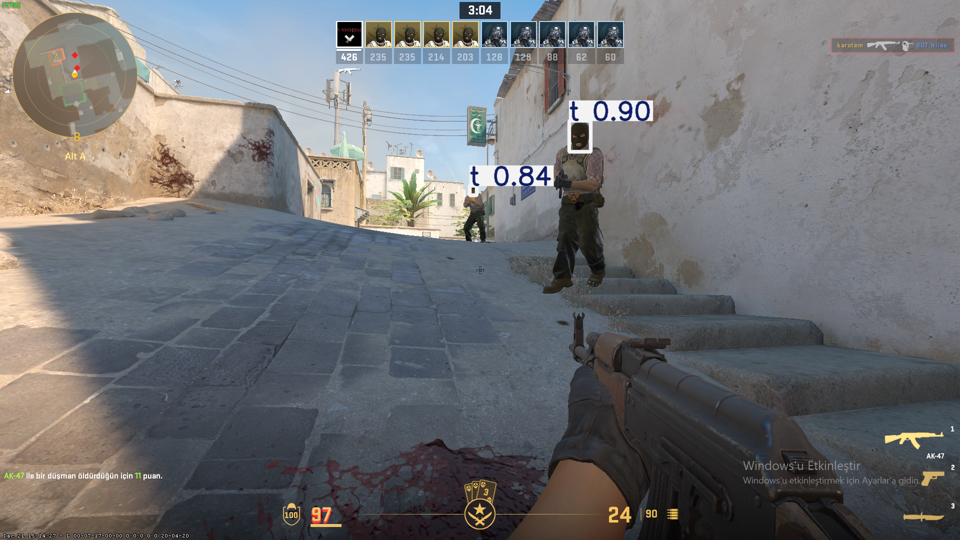


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_78.png: 1088x1920 1 t, 29.0ms
Speed: 5.2ms preprocess, 29.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1088, 1920)


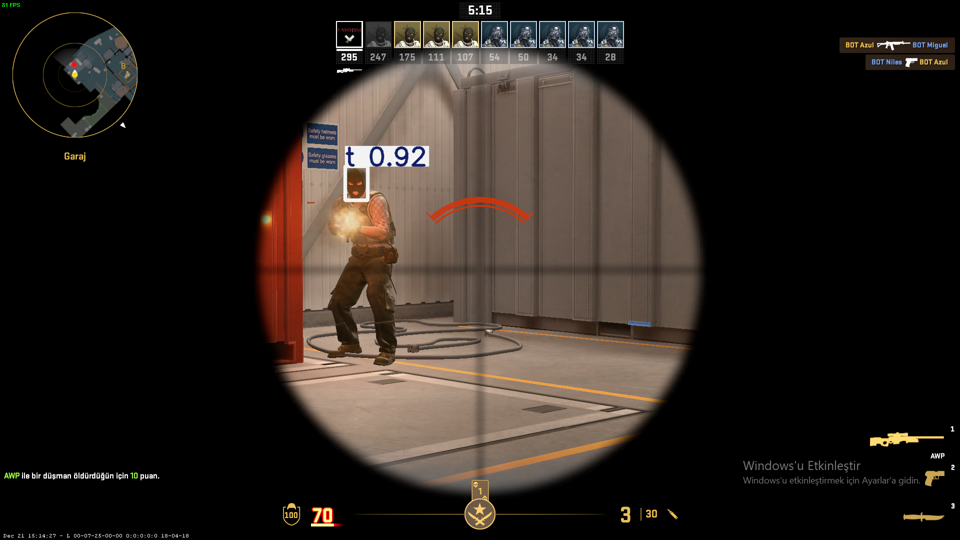

In [17]:
plotWithPIL('./N_1920_2_200.pt')

I've already change yaml file, hence I can't check result in "numbers" for this model. But it looks like not very accurate

Lets check bigger model (yolo8s)


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_19.png: 1088x1920 1 t, 29.0ms
Speed: 4.7ms preprocess, 29.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1088, 1920)


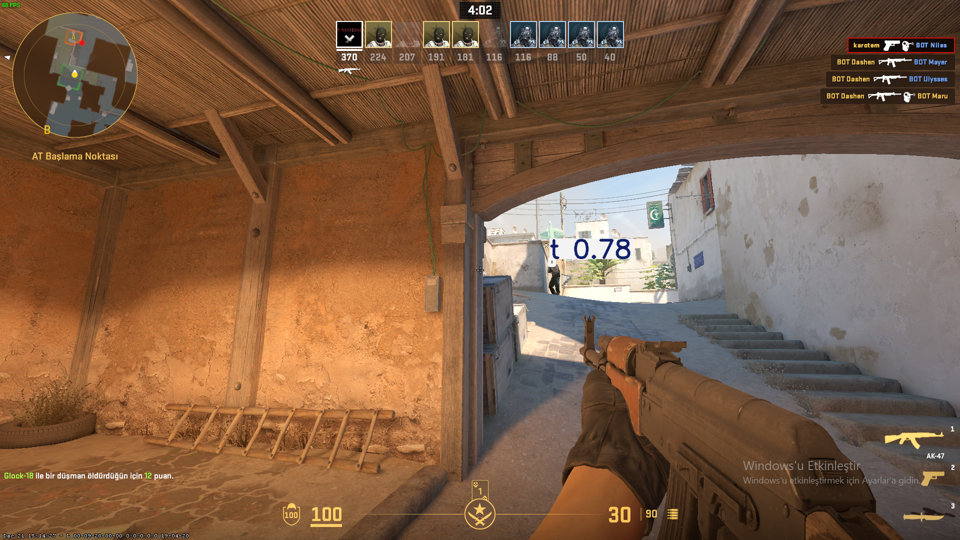


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_46.png: 1088x1920 1 ct, 28.5ms
Speed: 4.6ms preprocess, 28.5ms inference, 1.5ms postprocess per image at shape (1, 3, 1088, 1920)


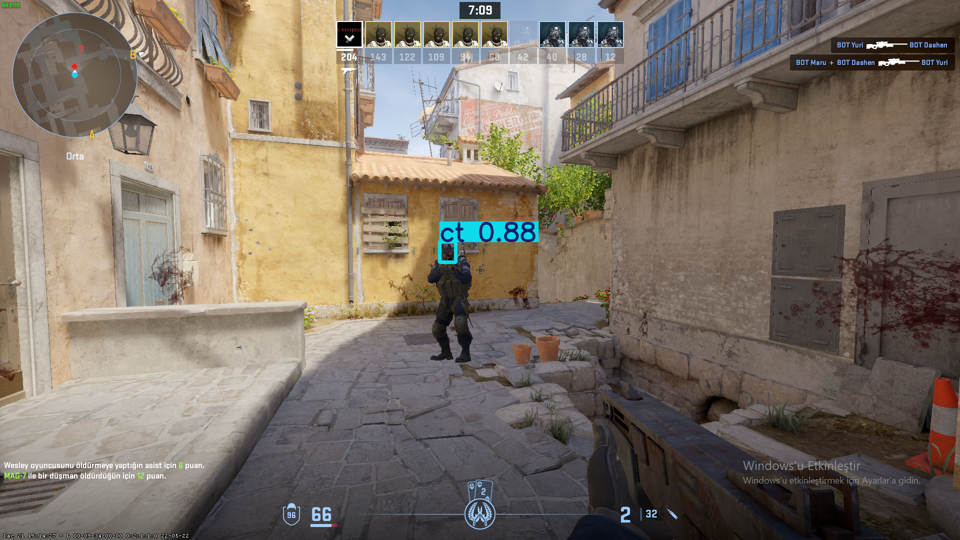


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_81.png: 1088x1920 1 t, 28.8ms
Speed: 4.6ms preprocess, 28.8ms inference, 5.7ms postprocess per image at shape (1, 3, 1088, 1920)


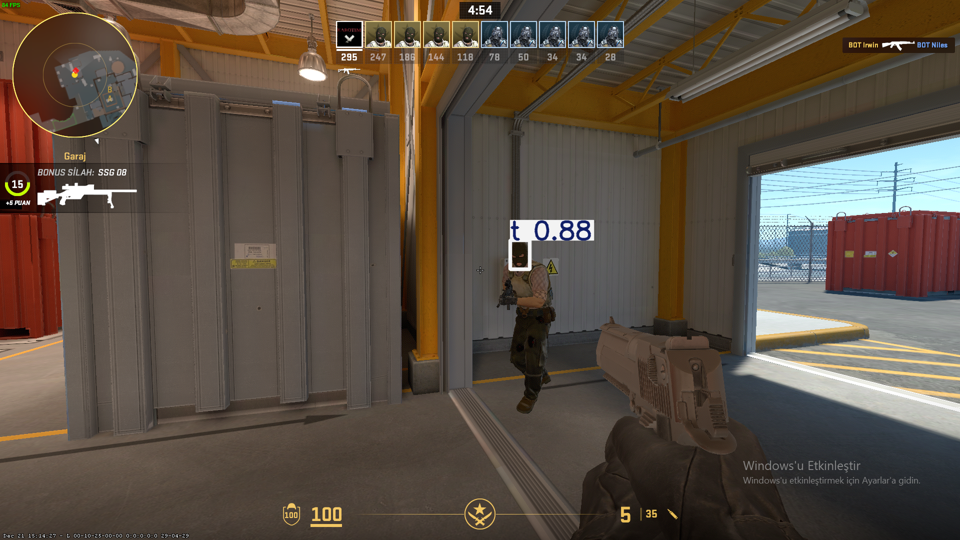


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_36.png: 1088x1920 1 t, 29.2ms
Speed: 4.9ms preprocess, 29.2ms inference, 2.2ms postprocess per image at shape (1, 3, 1088, 1920)


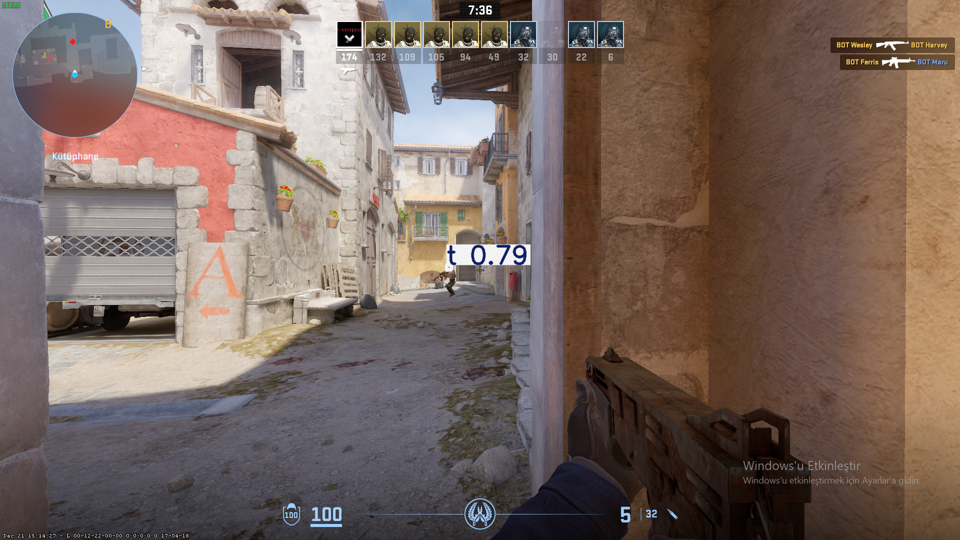


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_54.png: 1088x1920 1 t, 29.0ms
Speed: 5.8ms preprocess, 29.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1088, 1920)


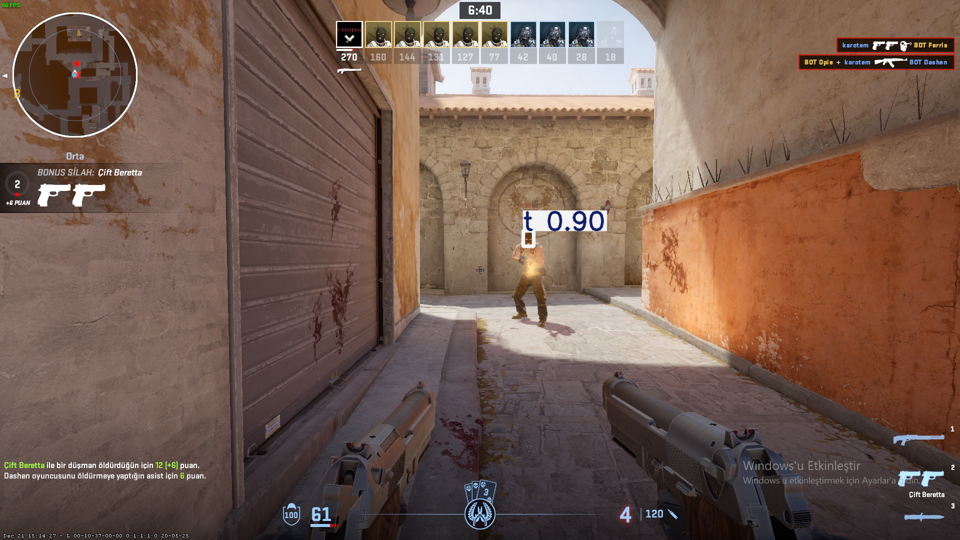


image 1/1 /mnt/e/CODE/ComputerVisionCourse/home_works/rd_final/datasets/val/images/img_79.png: 1088x1920 (no detections), 29.6ms
Speed: 4.6ms preprocess, 29.6ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)


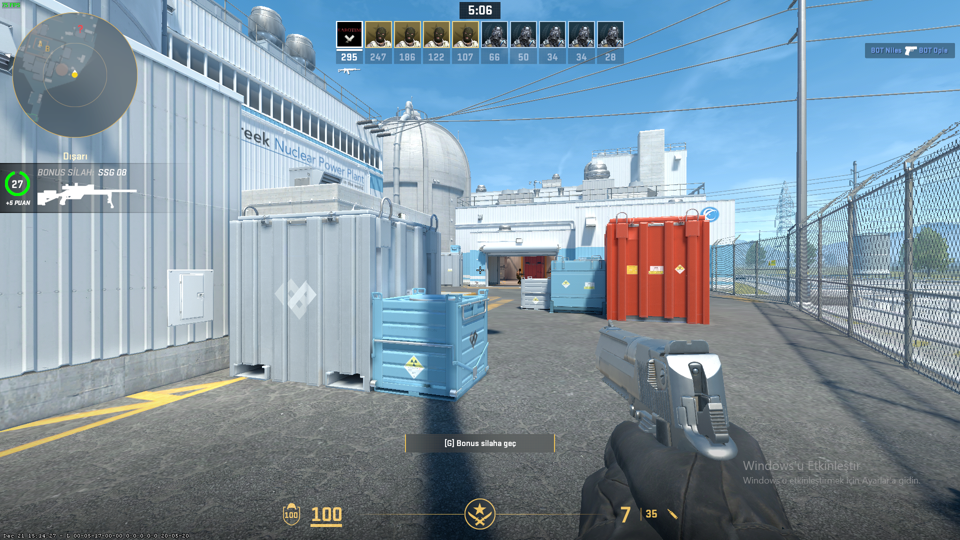

In [18]:
plotWithPIL('./S_1920_2_300.pt')

It looks better but but but

Every model spends a lot of time for prediction. Yolo8n in my config requires about 30ms
Yolo8s - more than 40ms.

For aiming purposes time for responce can't be strongly more than time between game frames. Even more. It's better if we can fit it inside single frame. 
Hence, there are not opportunity to use bigger models for aim. 